In [1]:
#!pip install git+https://github.com/huggingface/diffusers.git
!pip install transformers
!pip install segment_anything
!pip install safetensors
!pip install accelerate

In [2]:
!pip install diffusers==0.20.2

In [2]:
import transformers
from transformers import logging
import torch
from torch import autocast
import torchvision
from torchvision import transforms
from diffusers import DDIMScheduler
from diffusers import StableDiffusionPipeline
from diffusers import StableDiffusionInpaintPipeline
from diffusers import StableDiffusionControlNetInpaintPipeline, ControlNetModel, DDIMScheduler
from diffusers.utils import load_image
from diffusers import ControlNetModel, DiffusionPipeline, StableDiffusionXLControlNetPipeline,AutoencoderKL
from tqdm.auto import tqdm
import numpy as np
from matplotlib import pyplot as plt
import inspect
import requests
from io import BytesIO
import sys
import matplotlib.pyplot as plt
import cv2
import PIL
from PIL import Image
import torch
from diffusers.utils import load_image
import inspect
from typing import Any, Callable, Dict, List, Optional, Union, Tuple

import numpy as np
import PIL.Image
from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer

from diffusers import AutoencoderKL, ControlNetModel, UNet2DConditionModel
from diffusers.schedulers import KarrasDiffusionSchedulers
#from diffusers.pipeline_utils import DiffusionPipeline
from diffusers.pipelines.stable_diffusion import StableDiffusionPipelineOutput, StableDiffusionSafetyChecker
from diffusers.models.controlnet import ControlNetOutput

logger = logging.get_logger(__name__)  # pylint: disable=invalid-name

# Supress some unnecessary warnings when loading the CLIPTextModel
logging.set_verbosity_error()

# Set device
torch_device = "cuda:0" if torch.cuda.is_available() else "cpu"

In [2]:
!nvidia-smi

Sun Oct  1 15:59:00 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   43C    P8    10W /  70W |      3MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

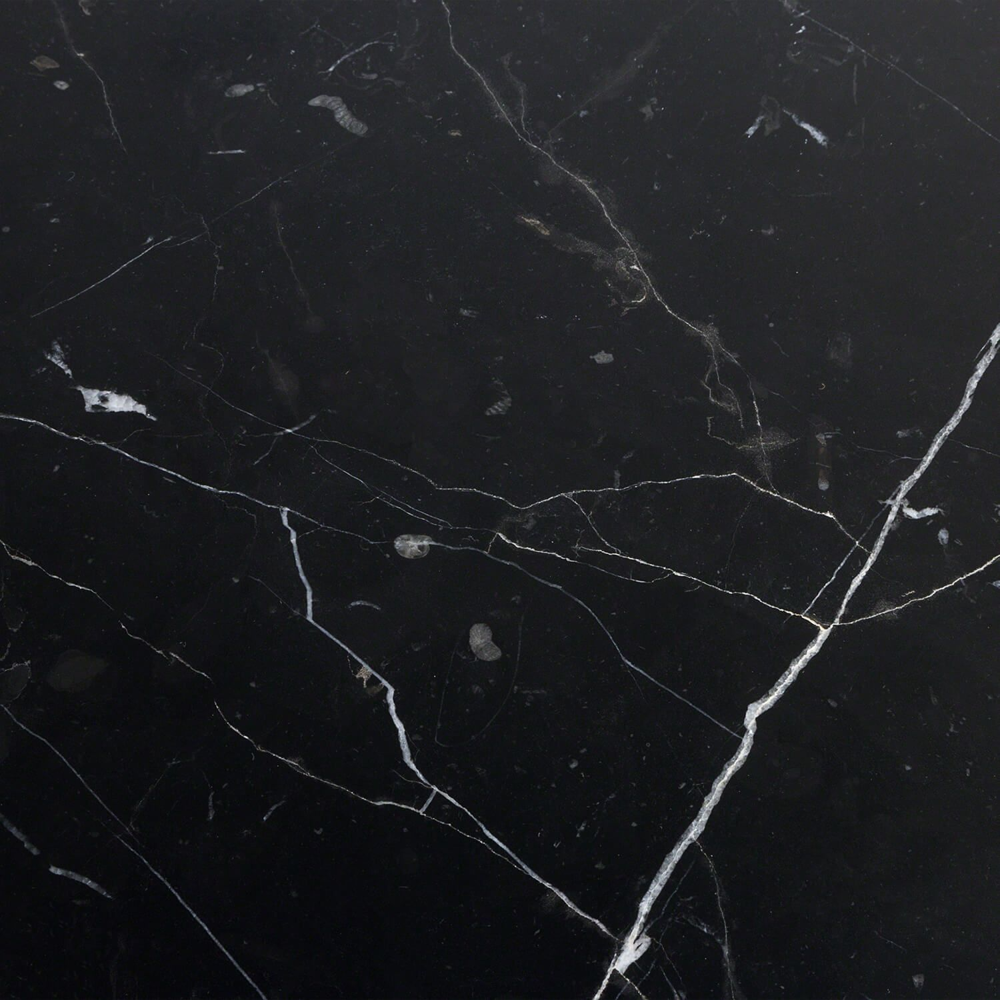

In [3]:
tile_single = Image.open("./tile_single.jpg")
tile_single

In [4]:
#number 1 tested model
controlnet12 = ControlNetModel.from_pretrained('lllyasviel/control_v11f1e_sd15_tile', 
                                             torch_dtype=torch.float16)
pipe12 = DiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5",
                                         custom_pipeline="stable_diffusion_controlnet_img2img",
                                         controlnet=controlnet12,
                                         torch_dtype=torch.float16).to('cuda')

/home/ec2-user/anaconda3/envs/pytorch_p310/lib/python3.10/site-packages/huggingface_hub/file_download.py:659: FutureWarning: 'cached_download' is the legacy way to download files from the HF hub, please consider upgrading to 'hf_hub_download'
  warnings.warn(
/home/ec2-user/.cache/huggingface/modules/diffusers_modules/git/stable_diffusion_controlnet_img2img.py:13: FutureWarning: Importing `StableDiffusionControlNetPipeline` or `MultiControlNetModel` from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_controlnet is deprecated. Please import `from diffusers import StableDiffusionControlNetPipeline` instead.
  from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_controlnet import MultiControlNetModel


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [5]:
def create_random_angle_matrix(row,column):
    newArray = numpy.random.randint(0, 5, size=(row, column))
    newArray = 90*newArray
    return newArray

In [7]:
def create_single_tile_grid_image_a_x_b(img,a,b):
    transform = transforms.Compose([
    transforms.PILToTensor()])
    tensor=[]
    random_arry = create_random_angle_matrix(a,b)
    for i in range(a):
        for j in range(b):
            tensor.append(transform(img.rotate(random_arry[i][j])))
    grid = make_grid(tensor, nrow = a)
    img = torchvision.transforms.ToPILImage()(grid)
    return img

In [8]:
def model_gridder(tensor_images,row,column):
    transform = transforms.Compose([
    transforms.PILToTensor()])
    tensor=[]
    random_arry = create_random_angle_matrix(a,b)
    for i in range(a):
        for j in range(b):
            tensor.append(transform(img.rotate(random_arry[i][j])))
    return tensor

In [9]:
def create_single_tile_grid_image_a_x_b(tensor,img,a,b):
    transform = transforms.Compose([
    transforms.PILToTensor()])
    if tensor is None:
        tensor=[]
        random_arry = create_random_angle_matrix(a,b)
        for i in range(a):
            for j in range(b):
                tensor.append(transform(img.rotate(random_arry[i][j])))
    grid = make_grid(tensor, nrow = a)
    img = torchvision.transforms.ToPILImage()(grid)
    return img

In [10]:
#Lets get rotated image tensor
def create_rotated_images_in_tensor_list(img,row,column):
    transform = transforms.Compose([
    transforms.PILToTensor()])
    tensor=[]
    random_array = numpy.random.randint(0, 5, size=(row, column))
    random_array = 90*random_array
    for i in range(row):
        for j in range(column):
            tensor.append(transform(img.rotate(random_array[i][j])))
    return tensor

In [11]:
#Lets get rotated image tensor
def create_rotated_images_in_PIL_list(img,row,column,angle):
    tensor=[]
    random_array = numpy.random.randint(0, 360/angle + 1, size=(row, column))
    random_array = angle*random_array
    for i in range(row):
        for j in range(column):
            tensor.append(img.rotate(random_array[i][j]))
    return tensor

In [12]:
def multiple_inferences_for_rotated_images(tensor,pipe,single_tile,row,column):
    images = []
    for i in range(len(tensor)):
        image = pipe(prompt="best quality, multipsssss", 
                 negative_prompt="blur, lowres, bad anatomy, bad hands, cropped, worst quality", 
                 image=single_tile, 
                 controlnet_conditioning_image=tensor[i], 
                 width=single_tile.size[0],
                 height=single_tile.size[1],
                 strength=1.0,
                 generator=torch.manual_seed(0),
                 num_inference_steps=10,
                ).images[0]
        images.append(image)
    return images

In [13]:
from diffusers import StableDiffusionControlNetInpaintPipeline, ControlNetModel
from diffusers.utils import load_image
import numpy as np
import torch
import torchvision
import random
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image
import torch

image = tile_single
image = image.resize((1024, 1024))
width, height = image.size

generator = torch.Generator(device="cuda").manual_seed(1)


In [14]:
def mask_generator(width, height,a,b):
    mask_length = random.randint(min(width, height) // a, min(width, height)// b)
    mask_x = random.randint(0, width - mask_length)
    mask_y = random.randint(0, height - mask_length)
    mask = torch.zeros(width, height)
    mask[mask_y: mask_y + mask_length, mask_x: mask_x + mask_length] = 1.0
    return mask

In [15]:
def grid_inf_pil(tens,row):
    transform = transforms.Compose([
    transforms.PILToTensor()])
    tensor=[]
    for i in range(len(tens)):
            tensor.append(transform(tens[i]))
    grid = make_grid(tensor, nrow = row )
    img = torchvision.transforms.ToPILImage()(grid)
    return img

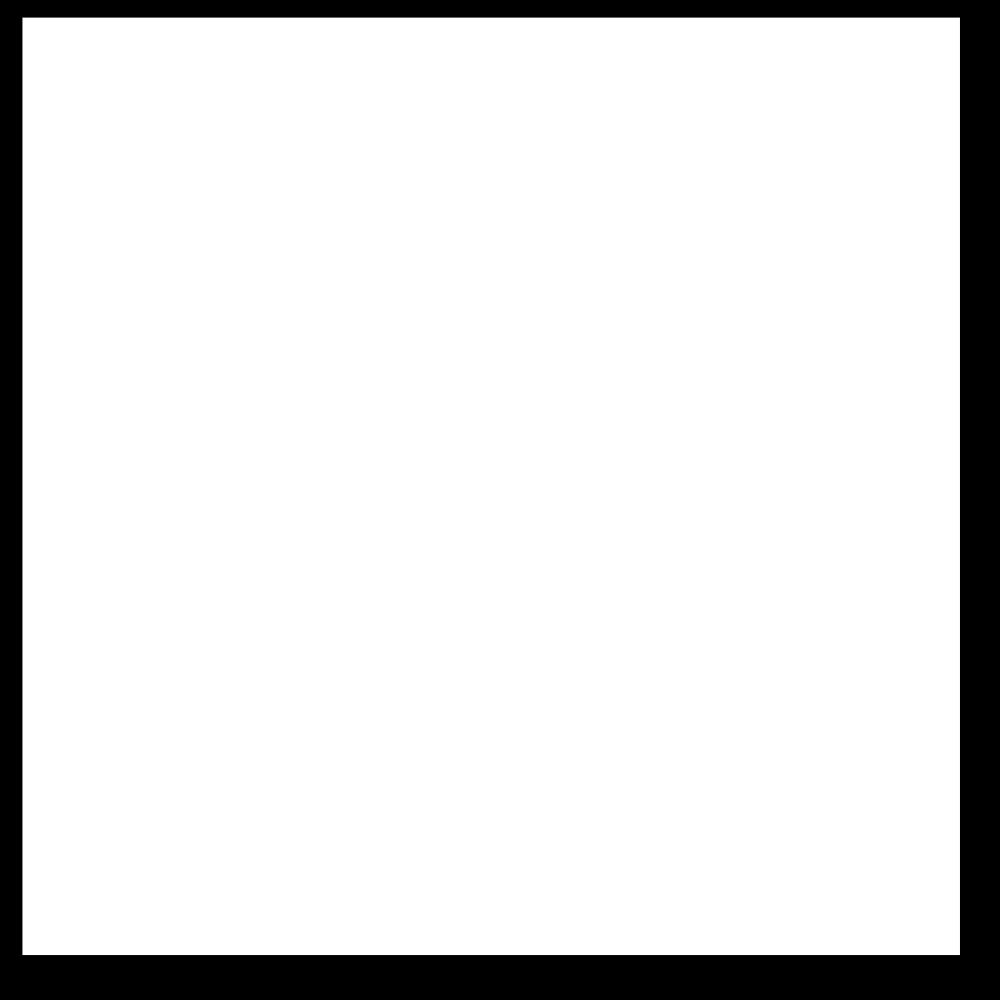

In [16]:
mask_image = mask_generator(width, height,2,1)
mask_image = torchvision.transforms.functional.to_pil_image(mask_image)
mask_image

In [32]:
torch.memory_format

torch.memory_format

In [33]:
!nvidia-smi

Sun Oct  1 14:47:35 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   35C    P0    32W /  70W |  15085MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [24]:
with torch.no_grad():
    torch.cuda.empty_cache()
    row = 3
    column = 3
    prompt = ""
    generator = torch.Generator(device="cuda").manual_seed(0)
    images_masked_gen = []
    pipe = AutoPipelineForInpainting.from_pretrained("diffusers/stable-diffusion-xl-1.0-inpainting-0.1", torch_dtype=torch.float16, variant="fp16").to("cuda")
    for i in range(row):
        for j in range(column):
            mask_image = mask_generator(width, height,3,2)
            mask_image = torchvision.transforms.functional.to_pil_image(mask_image)
            new_image = pipe(
              prompt=prompt,
              image=image,
              mask_image=mask_image,
              guidance_scale=0.0,
              num_inference_steps=20,  # steps between 15 and 30 work well for us
              strength=0.99,  # make sure to use `strength` below 1.0
              generator=generator,
            ).images[0]
            images_masked_gen.append(new_image)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'decay': 0.9999, 'inv_gamma': 1.0, 'min_decay': 0.0, 'optimization_step': 37000, 'power': 0.6666666666666666, 'update_after_step': 0, 'use_ema_warmup': False} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


OutOfMemoryError: CUDA out of memory. Tried to allocate 26.00 MiB (GPU 0; 14.75 GiB total capacity; 13.42 GiB already allocated; 16.81 MiB free; 13.77 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [34]:
pipe = None

In [35]:
!nvidia-smi

Sun Oct  1 14:50:52 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   34C    P0    32W /  70W |  15085MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

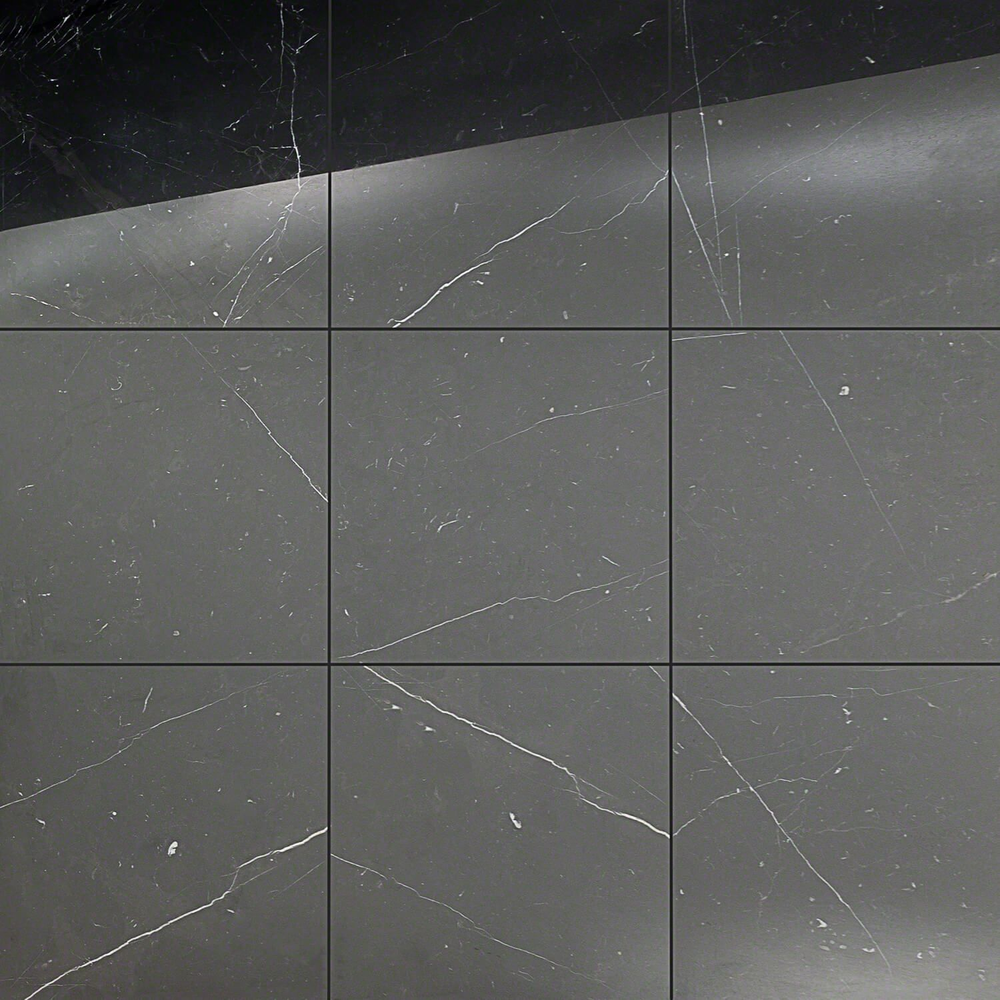

In [31]:
Image.open("./mul_tiles.jpg")

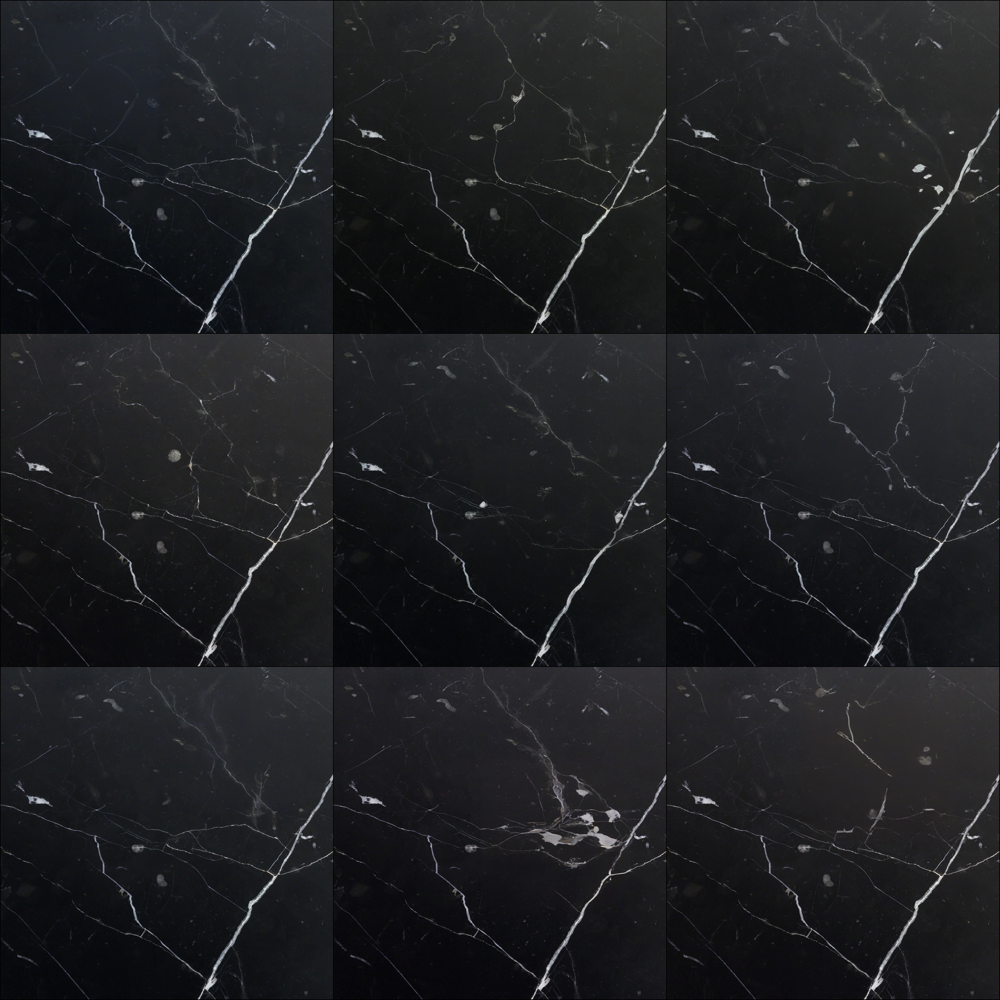

In [22]:
from torchvision.utils import make_grid
transform = transforms.Compose([
transforms.PILToTensor()])
tensor_x = []
for i in range(len(images_masked_gen)):
    tensor_x.append(transform(images_masked_gen[i]))
grid = make_grid(tensor_x, nrow = 3)
img = torchvision.transforms.ToPILImage()(grid)
img

In [22]:
#tens_pil_rotated = create_rotated_images_in_PIL_list(tile_single,3,3,angle=90)
x = multiple_inferences_for_rotated_images(tensor=images_masked_gen,pipe = pipe12,single_tile=tile_single.resize((1024,1024)),row = 3,column = 3)
result = grid_inf_pil(x,3)
result

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

NameError: name 'grid_inf_pil' is not defined

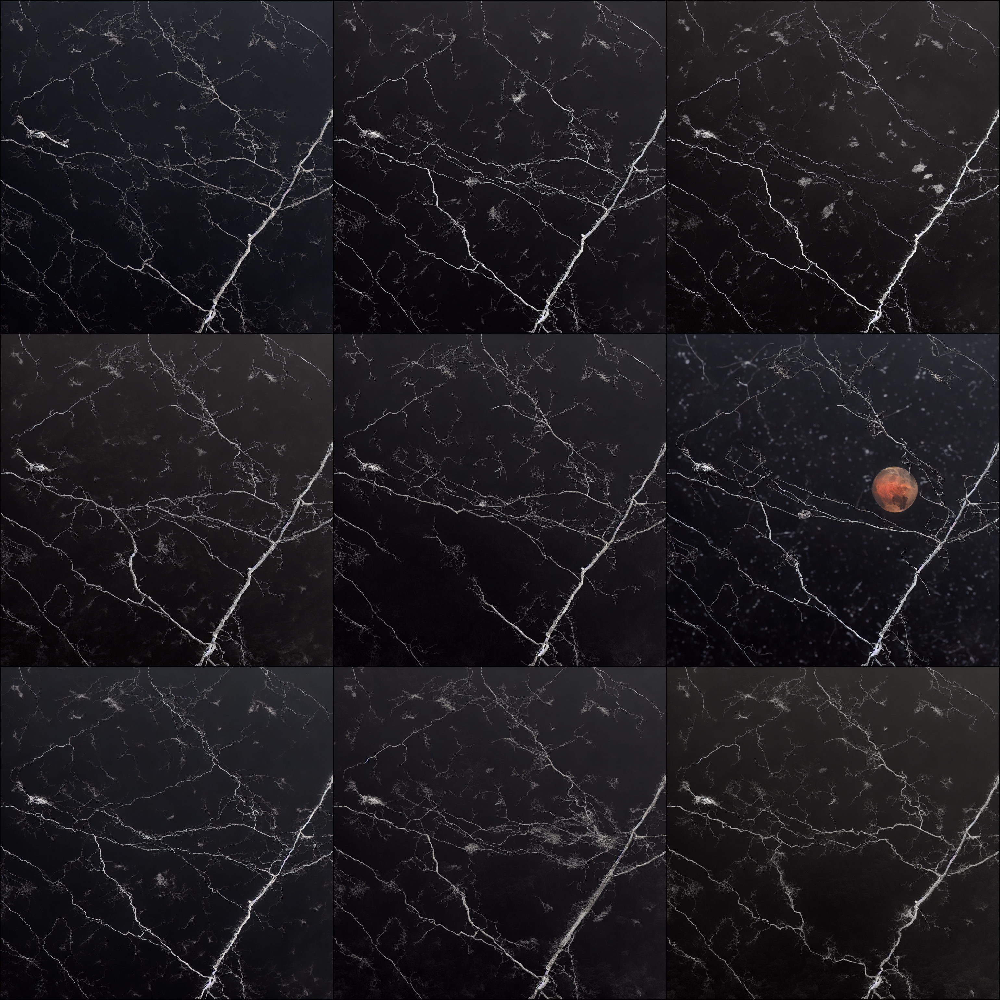

In [37]:
from torch.profiler import profile, record_function, ProfilerActivity

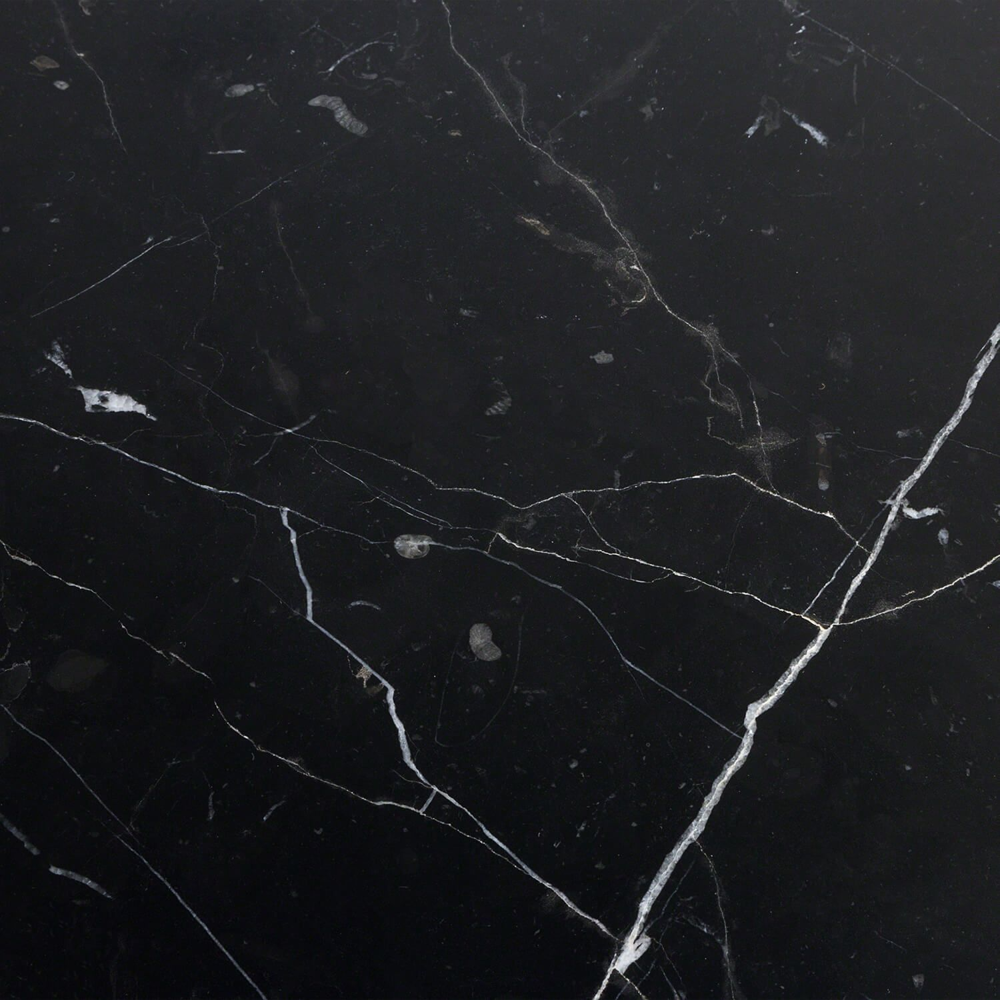

In [6]:
tile_single

In [8]:
img = tile_single.resize((1024,1024))